<a href="https://colab.research.google.com/github/shayanvafaei/PulseProtect/blob/main/MI_Detection_V2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Abstract

ECG Heartbeat Categorization Dataset

Abstract

This dataset is composed of two collections of heartbeat signals derived from two famous datasets in heartbeat classification, the **MIT-BIH Arrhythmia Dataset** and The **PTB Diagnostic ECG Database**. The number of samples in both collections is large enough for training a deep neural network.

This dataset has been used in exploring heartbeat classification using deep neural network architectures, and observing some of the capabilities of transfer learning on it. The signals correspond to electrocardiogram (ECG) shapes of heartbeats for the normal case and the cases affected by different arrhythmias and myocardial infarction. These signals are preprocessed and segmented, with each segment corresponding to a heartbeat.

Content

_ **Arrhythmia Dataset**

Number of Samples: 109446

Number of Categories: 5

Sampling Frequency: 125Hz

Data Source: Physionet's MIT-BIH Arrhythmia Dataset

AAMI EC57 (ANSI/AAMI EC57:1998) heartbeat classes

Classes: ['N': 0, 'S': 1, 'V': 2, 'F': 3, 'Q': 4]

| Label | Meaning (AAMI Class)         | Typical Beats Included                                                                                         |
| ----- | ---------------------------- | -------------------------------------------------------------------------------------------------------------- |
| **N** | **Normal**                   | Normal sinus beats and related non-ectopic beats (normal, left/right bundle branch block, atrial escape, etc.) |
| **S** | **Supraventricular ectopic** | Atrial premature beats, aberrant atrial beats, supraventricular premature beats                                |
| **V** | **Ventricular ectopic**      | Premature ventricular contractions (PVCs), ventricular escape beats                                            |
| **F** | **Fusion beats**             | Fusion of a normal and a ventricular beat                                                                      |
| **Q** | **Unknown/Unclassifiable**   | Beats that don’t fit the other classes or are of poor quality                                                  |

#

_ **The PTB Diagnostic ECG Database**

Number of Samples: 14552

Number of Categories: 2

Sampling Frequency: 125Hz

Data Source: Physionet's PTB Diagnostic Database

Remark: All the samples are cropped, downsampled and padded with zeroes if necessary to the fixed dimension of 188.

---------------------------------------------------------------------------

Data Files
This dataset consists of a series of CSV files. Each of these CSV files contain a matrix, with each row representing an example in that portion of the dataset. The final element of each row denotes the class to which that example belongs.

Acknowledgements
Mohammad Kachuee, Shayan Fazeli, and Majid Sarrafzadeh. "ECG Heartbeat Classification: A Deep Transferable Representation." arXiv preprint arXiv:1805.00794 (2018).

Inspiration
Can you identify myocardial infarction?

## Requirements

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
!pip install -q tensorflow

In [5]:
import pandas as pd
import zipfile
import os

import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.over_sampling import SMOTE
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import StandardScaler

In [6]:
# Already Unzipped
"""
zip_path = '/content/drive/MyDrive/MI Detection/archive.zip'
extract_folder = '/content/drive/MyDrive/MI Detection/Data'

os.makedirs(extract_folder, exist_ok=True)

with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_folder)
print("Extraction completed.")
"""

'\nzip_path = \'/content/drive/MyDrive/MI Detection/archive.zip\'\nextract_folder = \'/content/drive/MyDrive/MI Detection/Data\'\n\nos.makedirs(extract_folder, exist_ok=True)\n\nwith zipfile.ZipFile(zip_path, \'r\') as zip_ref:\n    zip_ref.extractall(extract_folder)\nprint("Extraction completed.")\n'

## **Data Utils**

## PTB Diagnostic ECG database

In [7]:
ptb_ndata = pd.read_csv(r"/content/drive/MyDrive/MI Detection/Data/ptbdb_normal.csv",header=None)
#This is the normal ptbdb where the last column for all rows is 0 meaning these patients were healthy.

In [8]:
ptb_ndata.head(2)

,0,1,2,3,4,5,6,7,8,9,...,178,179,180,181,182,183,184,185,186,187
0,1.0,0.900324,0.358590,0.051459,0.046596,0.126823,0.133306,0.119125,0.110616,0.113047,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1.0,0.794681,0.375387,0.116883,0.000000,0.171923,0.283859,0.293754,0.325912,0.345083,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [9]:
print("PTB Normal Data shape: ", ptb_ndata.shape)

PTB Normal Data shape:  (4046, 188)


In [10]:
ptb_abdata = pd.read_csv(r"/content/drive/MyDrive/MI Detection/Data/ptbdb_abnormal.csv",header=None)
#The last column is observed to be 1 for all rows meaning these patients were infected with MI

In [11]:
print("PTB Abnormal Data shape: ", ptb_abdata.shape)

PTB Abnormal Data shape:  (10506, 188)


In [12]:
ptb_abdata.head(2)

,0,1,2,3,4,5,6,7,8,9,...,178,179,180,181,182,183,184,185,186,187
0,0.932233,0.869679,0.886186,0.929626,0.908775,0.933970,0.801043,0.749783,0.687229,0.635100,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,1.000000,0.606941,0.384181,0.254237,0.223567,0.276836,0.253430,0.184826,0.153349,0.121872,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


Sampling frequency = 125Hz

This indicates that the time scale = 1/125 = 0.008seconds

In [13]:
ptb_ndata.shape[1] - 1

187

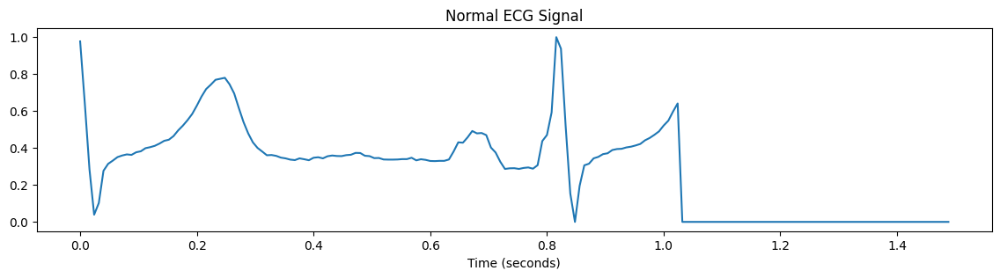

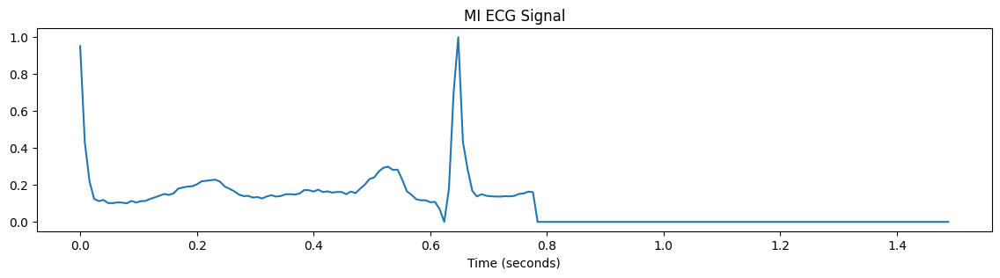

In [14]:
#@title Sample Signals
# Define the time scale
time_scale = 0.008  #seconds  = 1/125Hz

# Generate time axis based on the time scale
time_axis = np.arange(ptb_ndata.shape[1] - 1) * time_scale #1.504s

# Randomly select a signal
random_row_index = np.random.randint(0, ptb_ndata.shape[0])

# Plot Normal ECG signal with adjusted time scale
plt.figure(figsize=(14, 3))
plt.plot(time_axis, ptb_ndata.iloc[random_row_index, :-1])
plt.title("Normal ECG Signal")
plt.xlabel("Time (seconds)")
plt.show()

# Plot MI ECG signal with adjusted time scale
plt.figure(figsize=(14, 3))
plt.plot(time_axis, ptb_abdata.iloc[random_row_index, :-1])
plt.title("MI ECG Signal")
plt.xlabel("Time (seconds)")
plt.show()

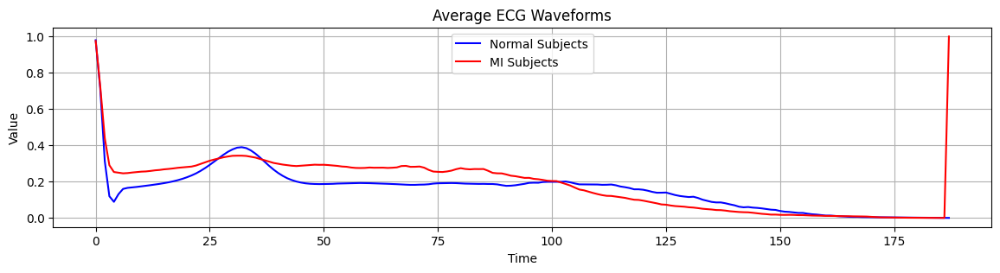

In [15]:
#@title Average ECG Waveform
# Calculate average ECG waveform for normal subjects
ptb_avg_ndata = np.mean(ptb_ndata, axis=0)

# Calculate average ECG waveform for MI subjects
ptb_avg_abdata = np.mean(ptb_abdata, axis=0)

# Plotting average ECG waveforms
plt.figure(figsize=(14, 3))
plt.plot(ptb_avg_ndata, label='Normal Subjects', color='blue')
plt.plot(ptb_avg_abdata, label='MI Subjects', color='red')
plt.title('Average ECG Waveforms')
plt.xlabel('Time')
plt.ylabel('Value')
plt.legend()
plt.grid(True)
plt.show()

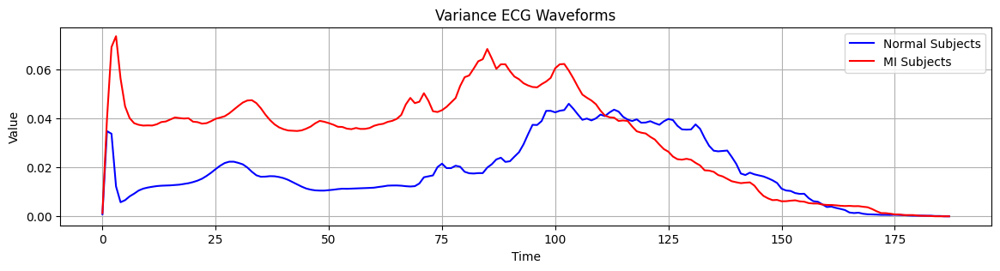

In [16]:
#@title Variance ECG Waveform
# Calculate variance ECG waveform for normal subjects
ptb_var_ndata = np.var(ptb_ndata, axis=0)

# Calculate average ECG waveform for MI subjects
ptb_var_abdata = np.var(ptb_abdata, axis=0)

# Plotting average ECG waveforms
plt.figure(figsize=(14, 3))
plt.plot(ptb_var_ndata, label='Normal Subjects', color='blue')
plt.plot(ptb_var_abdata, label='MI Subjects', color='red')
plt.title('Variance ECG Waveforms')
plt.xlabel('Time')
plt.ylabel('Value')
plt.legend()
plt.grid(True)
plt.show()

In [17]:
#@title Concatenate Data
ptb_concatenated_data = pd.concat([ptb_ndata, ptb_abdata],ignore_index=True)
ptb_shuffled_data = ptb_concatenated_data.sample(frac=1, random_state=0) # shuffle the data
ptb_shuffled_data.head(2)

,0,1,2,3,4,5,6,7,8,9,...,178,179,180,181,182,183,184,185,186,187
13047,1.0,0.546901,0.032509,0.054182,0.080596,0.115137,0.151710,0.170674,0.160853,0.162547,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1392,1.0,0.514158,0.109091,0.034873,0.037258,0.112668,0.152012,0.184501,0.203875,0.213413,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [18]:
#@title Shuffle Data
ptb_all_data = ptb_shuffled_data
ptb_all_data.reset_index(drop=True, inplace=True)
ptb_all_data.shape

(14552, 188)

In [19]:
#@title Status (labels)
ptb_all_data.rename(columns={ptb_ndata.columns[-1]: 'Status'}, inplace=True)

In [20]:
ptb_all_data.head(2)

,0,1,2,3,4,5,6,7,8,9,...,178,179,180,181,182,183,184,185,186,Status
0,1.0,0.546901,0.032509,0.054182,0.080596,0.115137,0.151710,0.170674,0.160853,0.162547,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,1.0,0.514158,0.109091,0.034873,0.037258,0.112668,0.152012,0.184501,0.203875,0.213413,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [21]:
ptb_all_data.shape

(14552, 188)

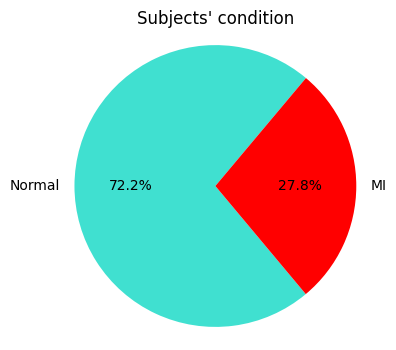

In [22]:
#@title Data Distribution  Before SMOTE
# Assuming the last column is named 'Status' where 0 represents normal and 1 represents infected

# Count occurrences of each category
ptb_status_counts = ptb_all_data['Status'].value_counts()
ptb_label = ['Normal', 'MI']

# Plot the pie chart
plt.figure(figsize=(4, 4))
plt.pie(ptb_status_counts, labels=ptb_label, autopct='%1.1f%%', startangle=50, colors=['turquoise', 'red'])
plt.title("Subjects' condition")
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.show()

In [25]:
ptb_data = ptb_all_data.iloc[:,:-1]
ptb_data.shape

(14552, 187)

In [26]:
#@title Features and Labels
# Extract the features and labels
ptb_X = ptb_all_data.iloc[:, :-1]
ptb_y = ptb_all_data.iloc[:, -1]

# Apply SMOTE to balance the class distribution
smote = SMOTE(random_state=42)
ptb_X_resampled, ptb_y_resampled = smote.fit_resample(ptb_X, ptb_y)

# Check the class distribution after resampling
ptb_unique, ptb_counts = np.unique(ptb_y_resampled, return_counts=True)
print("Class distribution after resampling:", dict(zip(ptb_unique, ptb_counts)))

Class distribution after resampling: {np.float64(0.0): np.int64(10506), np.float64(1.0): np.int64(10506)}


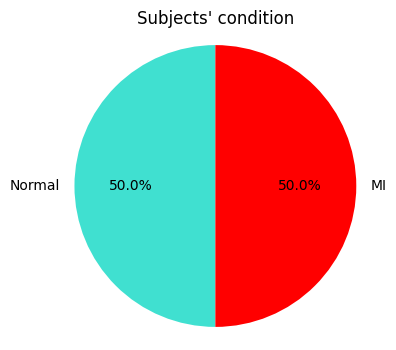

In [27]:
#@title Data Distribution After SMOTE
# Assuming the last column is named 'Status' where 0 represents normal and 1 represents infected

# Count occurrences of each category
#status_counts = all_data['Status'].value_counts()
ptb_label = ['Normal', 'MI']

# Plot the pie chart
plt.figure(figsize=(4, 4))
plt.pie(ptb_counts, labels=ptb_label, autopct='%1.1f%%', startangle=90, colors=['turquoise', 'red'])
plt.title("Subjects' condition")
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.show()

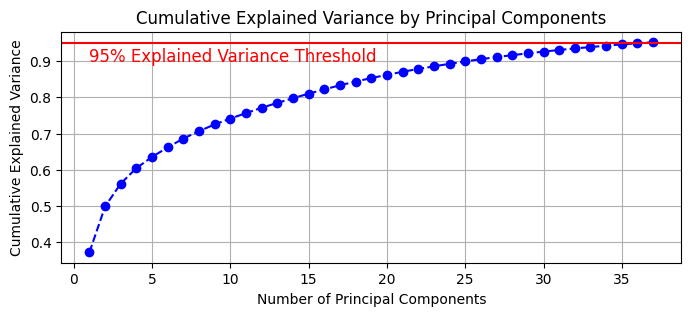

Shape of PCA features after SMOTE: (21012, 37)


In [28]:
#@title PCA

pca = PCA(n_components=0.95)  # Retain 95% of variance
pca.fit(ptb_X_resampled)

# Calculate cumulative explained variance ratio
ptb_cumulative_variance = np.cumsum(pca.explained_variance_ratio_)

# Plot cumulative variance
plt.figure(figsize=(8, 3))
plt.plot(range(1, len(ptb_cumulative_variance) + 1), ptb_cumulative_variance, marker='o', linestyle='--', color='b')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Cumulative Explained Variance by Principal Components')
plt.grid(True)
plt.axhline(y=0.95, color='r', linestyle='-')
plt.text(1, 0.90, '95% Explained Variance Threshold', color='red', fontsize=12)
plt.show()

# Transform the data
ptb_pca_features = pca.transform(ptb_X_resampled)

# Print the shape of PCA features
print("Shape of PCA features after SMOTE:", ptb_pca_features.shape)

Number of components explaining 95% variance: 6


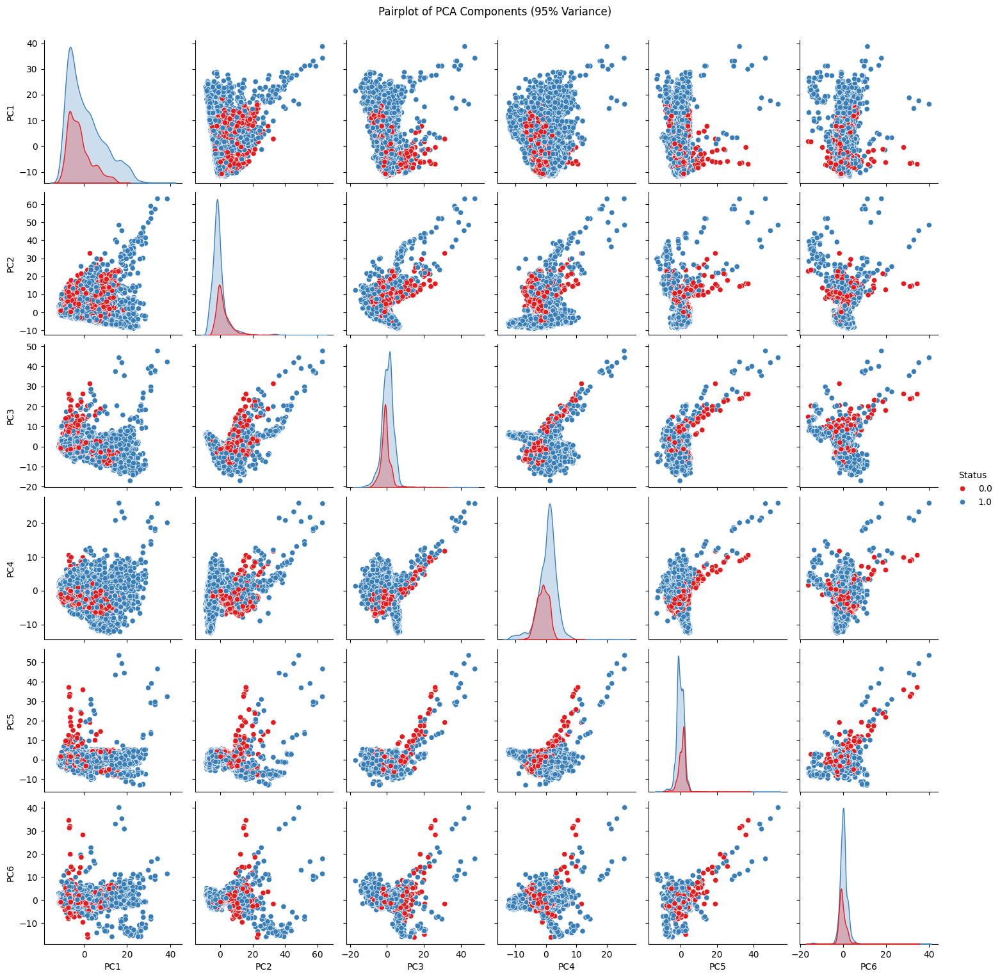

In [41]:
#@title Scatterplot

# Separate features and target
ptb_X_pp = ptb_all_data.drop(columns=["Status"])
ptb_y_pp = ptb_all_data["Status"]

scaler = StandardScaler()
ptb_X_scaled_pp = scaler.fit_transform(ptb_X)

pca = PCA(n_components=6)
ptb_X_pca_pp = pca.fit_transform(ptb_X_scaled_pp)

# How many components were chosen?
print("Number of components explaining 95% variance:", pca.n_components_)

# 3️⃣ Build a DataFrame with all PCs and Status
pc_cols_pp = [f"PC{i+1}" for i in range(pca.n_components_)]
pca_pp = pd.DataFrame(ptb_X_pca_pp, columns=pc_cols_pp)
pca_pp["Status"] = ptb_y_pp.values

# 4️⃣ Pairplot
sns.pairplot(
    pca_pp,
    vars=pc_cols_pp,    # all principal components selected
    hue="Status",
    palette="Set1",
    diag_kind="kde"
)
plt.suptitle("Pairplot of PCA Components (95% Variance)", y=1.02)
plt.show()

In [29]:
from sklearn.model_selection import train_test_split
ptb_X_train, ptb_X_test, ptb_y_train, ptb_y_test = train_test_split(ptb_pca_features, ptb_y_resampled, test_size=0.2, random_state=42)

In [30]:
print("The shape of X_train : ", ptb_X_train.shape)
print("The shape of X_test : ", ptb_X_test.shape)
print("The shape of y_train : ", ptb_y_train.shape)
print("The shape of y_test : ", ptb_y_test.shape)

The shape of X_train :  (16809, 37)
The shape of X_test :  (4203, 37)
The shape of y_train :  (16809,)
The shape of y_test :  (4203,)


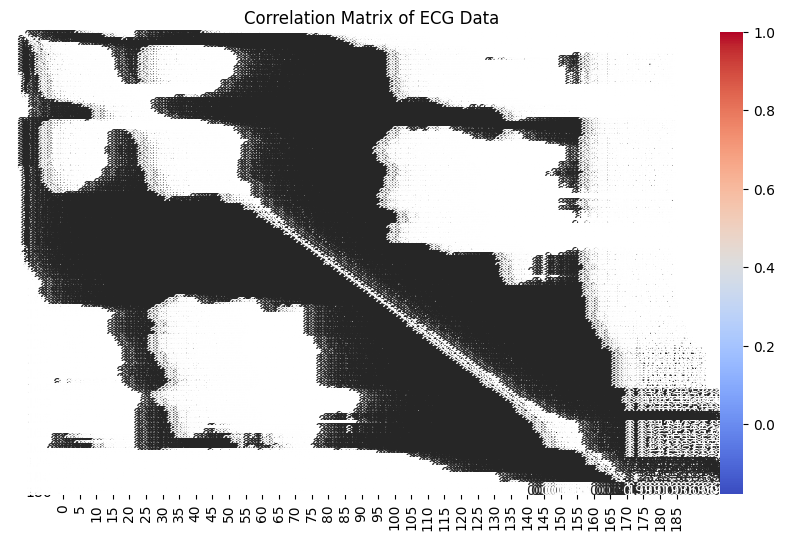

In [44]:
#@title Correlation Matrix
# Compute the correlation matrix
corr = ptb_data.corr()
#corr = np.corrcoef(pca_features, rowvar=False)

# Plot
plt.figure(figsize=(10, 6))
sns.heatmap(corr,
            annot=True,       # show correlation values
            fmt=".10f",        # 2 decimal places
            cmap="coolwarm",  # color map
            cbar=True)
plt.title("Correlation Matrix of ECG Data")
plt.show()

## Analysis

Accuracy of KNN classifier with K=2: 0.9500356887937188


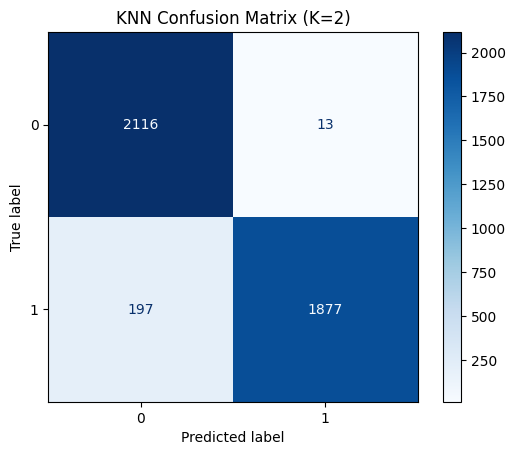

The Accuracy of 1 is: 0.9735902926481085
The Accuracy of 2 is: 0.9500356887937188
The Accuracy of 3 is: 0.9564596716630978
The Accuracy of 4 is: 0.9381394242207947
The Accuracy of 5 is: 0.9469426600047585
The Accuracy of 6 is: 0.9343326195574589
The Accuracy of 7 is: 0.9381394242207947
The Accuracy of 8 is: 0.9288603378539139
The Accuracy of 9 is: 0.9340946942660004
The Accuracy of 10 is: 0.9238639067332858


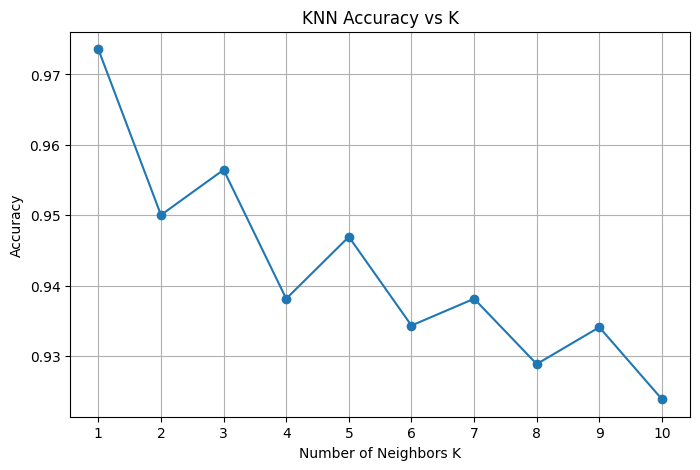

In [49]:
#@title KNN

from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score

# Create and train KNN classifier
n_neighbors = 2
knn = KNeighborsClassifier(n_neighbors=n_neighbors)
knn.fit(ptb_X_train, ptb_y_train)

# Predict on the test set
ptb_y_pred_knn = knn.predict(ptb_X_test)

# Evaluate accuracy
ptb_accuracy_knn = accuracy_score(ptb_y_test, ptb_y_pred_knn)
print(f"Accuracy of KNN classifier with K={n_neighbors}:", ptb_accuracy_knn)

########################
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

cm = confusion_matrix(ptb_y_test, ptb_y_pred_knn)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
disp.plot(cmap='Blues')
plt.title(f"KNN Confusion Matrix (K={n_neighbors})")
plt.show()

########################
k_values = range(1, 11)
accuracies = []

for k in k_values:
    knn = KNeighborsClassifier(n_neighbors=k)
    knn.fit(ptb_X_train, ptb_y_train)
    ptb_y_pred = knn.predict(ptb_X_test)
    accuracies.append(accuracy_score(ptb_y_test, ptb_y_pred))
    print(f"The Accuracy of {k} is: {accuracy_score(ptb_y_test, ptb_y_pred)}")

plt.figure(figsize=(8,5))
plt.plot(k_values, accuracies, marker='o')
plt.xlabel("Number of Neighbors K")
plt.ylabel("Accuracy")
plt.title("KNN Accuracy vs K")
plt.xticks(k_values)
plt.grid(True)
plt.show()


Accuracy of SVM classifier: 0.9412324530097549


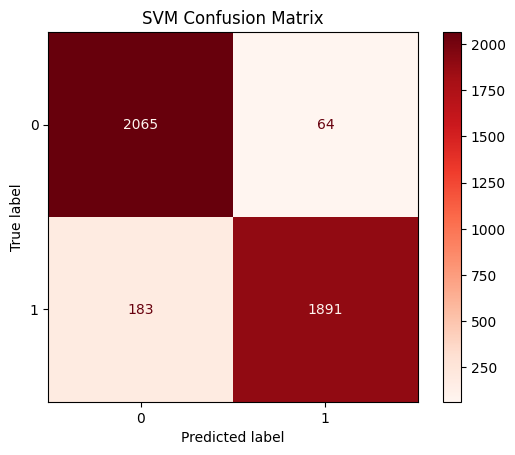

The Accuracy of linear is: 0.7872947894361171
The Accuracy of poly is: 0.9412324530097549
The Accuracy of rbf is: 0.9286224125624554
The Accuracy of sigmoid is: 0.5248631929574114


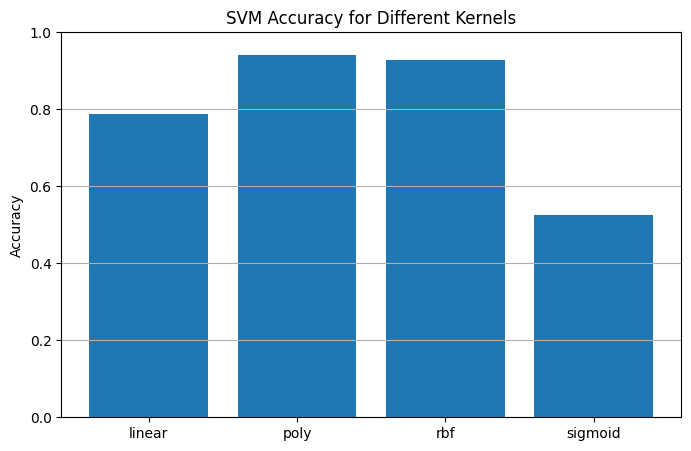

In [52]:
#@title SVC
from sklearn.svm import SVC

# Create and train SVM classifier
#svm = SVC(kernel='linear', random_state=42)
#svm = SVC(kernel='sigmoid', gamma='scale', coef0=0.0, random_state=42)
svm = SVC(kernel='poly', degree=3, gamma='scale', coef0=1,probability=True, random_state=42)
svm.fit(ptb_X_train, ptb_y_train)

# Predict on the test set
ptb_y_pred_svm = svm.predict(ptb_X_test)

# Evaluate accuracy
ptb_accuracy_svm = accuracy_score(ptb_y_test, ptb_y_pred_svm)
print("Accuracy of SVM classifier:", ptb_accuracy_svm)


from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

cm = confusion_matrix(ptb_y_test, ptb_y_pred_svm)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
disp.plot(cmap='Reds')
plt.title("SVM Confusion Matrix")
plt.show()

########################
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score

kernels = ['linear', 'poly', 'rbf', 'sigmoid']
accuracies = []

for k in kernels:
    svm = SVC(kernel=k, degree=3 if k=='poly' else 3, gamma='scale', coef0=1, random_state=42)
    svm.fit(ptb_X_train, ptb_y_train)
    y_pred = svm.predict(ptb_X_test)
    accuracies.append(accuracy_score(ptb_y_test, y_pred))
    print(f"The Accuracy of {k} is: {accuracy_score(ptb_y_test, y_pred)}")

plt.figure(figsize=(8,5))
plt.bar(kernels, accuracies)
plt.ylabel("Accuracy")
plt.title("SVM Accuracy for Different Kernels")
plt.ylim(0, 1)
plt.grid(axis='y')
plt.show()

########################


Accuracy of Random Forest classifier: 0.9631215798239353


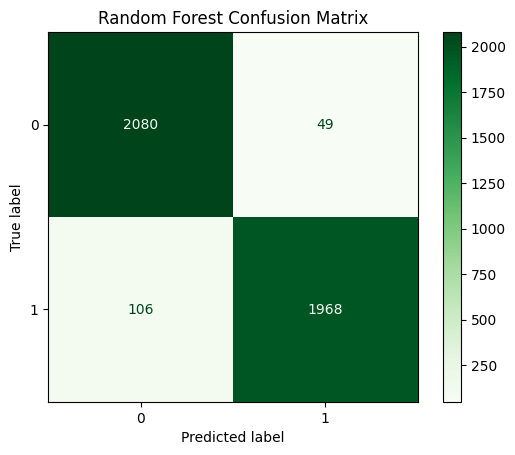

The Accuracy of sigmoid is: 0.9512253152510112
The Accuracy of sigmoid is: 0.9640732809897692
The Accuracy of sigmoid is: 0.9616940280751843
The Accuracy of sigmoid is: 0.9631215798239353
The Accuracy of sigmoid is: 0.9628836545324768


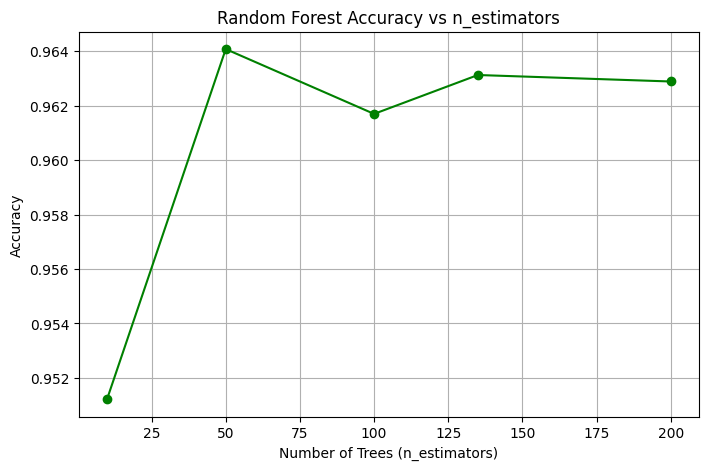

In [51]:
#@title Random Forest

from sklearn.ensemble import RandomForestClassifier

# Create and train Random Forest classifier
ptb_rf = RandomForestClassifier(n_estimators=135, random_state=42)
ptb_rf.fit(ptb_X_train, ptb_y_train)

# Predict on the test set
ptb_y_pred_rf = ptb_rf.predict(ptb_X_test)

# Evaluate accuracy
ptb_accuracy_rf = accuracy_score(ptb_y_test, ptb_y_pred_rf)
print("Accuracy of Random Forest classifier:", ptb_accuracy_rf)

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

cm = confusion_matrix(ptb_y_test, ptb_y_pred_rf)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
disp.plot(cmap='Greens')
plt.title("Random Forest Confusion Matrix")
plt.show()

########################

from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

n_estimators_list = [10, 50, 100, 135, 200]
accuracies = []

for n in n_estimators_list:
    rf = RandomForestClassifier(n_estimators=n, random_state=42)
    rf.fit(ptb_X_train, ptb_y_train)
    ptb_y_pred = rf.predict(ptb_X_test)
    accuracies.append(accuracy_score(ptb_y_test, ptb_y_pred))
    print(f"The Accuracy of {k} is: {accuracy_score(ptb_y_test, ptb_y_pred)}")

plt.figure(figsize=(8,5))
plt.plot(n_estimators_list, accuracies, marker='o', color='green')
plt.xlabel("Number of Trees (n_estimators)")
plt.ylabel("Accuracy")
plt.title("Random Forest Accuracy vs n_estimators")
plt.grid(True)
plt.show()


In [57]:
#@title Accuracy, Precision, Recall, F1
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix

# K-NearestNeighbors Evaluation
ptb_knn_accuracy = accuracy_score(ptb_y_test, ptb_y_pred_knn)
ptb_knn_precision = precision_score(ptb_y_test, ptb_y_pred_knn)
ptb_knn_recall = recall_score(ptb_y_test, ptb_y_pred_knn)
ptb_knn_f1 = f1_score(ptb_y_test, ptb_y_pred_knn)

print("\nKNN Metrics:")
print("Accuracy:", ptb_knn_accuracy)
print("Precision:", ptb_knn_precision)
print("Recall:", ptb_knn_recall)
print("F1 Score:", ptb_knn_f1)

# Support Vector Machine Evaluation
ptb_svm_accuracy = accuracy_score(ptb_y_test, ptb_y_pred_svm )
ptb_svm_precision = precision_score(ptb_y_test, ptb_y_pred_svm )
ptb_svm_recall = recall_score(ptb_y_test, ptb_y_pred_svm )
ptb_svm_f1 = f1_score(ptb_y_test, ptb_y_pred_svm )

print("\nSVM Metrics:")
print("Accuracy:", ptb_svm_accuracy)
print("Precision:", ptb_svm_precision)
print("Recall:", ptb_svm_recall)
print("F1 Score:", ptb_svm_f1)

# Random Forest Evaluation
ptb_rf_accuracy = accuracy_score(ptb_y_test, ptb_y_pred_rf)
ptb_rf_precision = precision_score(ptb_y_test, ptb_y_pred_rf)
ptb_rf_recall = recall_score(ptb_y_test, ptb_y_pred_rf)
ptb_rf_f1 = f1_score(ptb_y_test, ptb_y_pred_rf)

print("\nRandom Forest Metrics:")
print("Accuracy:", ptb_rf_accuracy)
print("Precision:", ptb_rf_precision)
print("Recall:", ptb_rf_recall)
print("F1 Score:", ptb_rf_f1)


KNN Metrics:
Accuracy: 0.9500356887937188
Precision: 0.9931216931216931
Recall: 0.9050144648023144
F1 Score: 0.9470232088799193

SVM Metrics:
Accuracy: 0.9412324530097549
Precision: 0.9672634271099744
Recall: 0.9117647058823529
F1 Score: 0.9386944651278233

Random Forest Metrics:
Accuracy: 0.9631215798239353
Precision: 0.9757064947942489
Recall: 0.9488910318225651
F1 Score: 0.9621119530677096


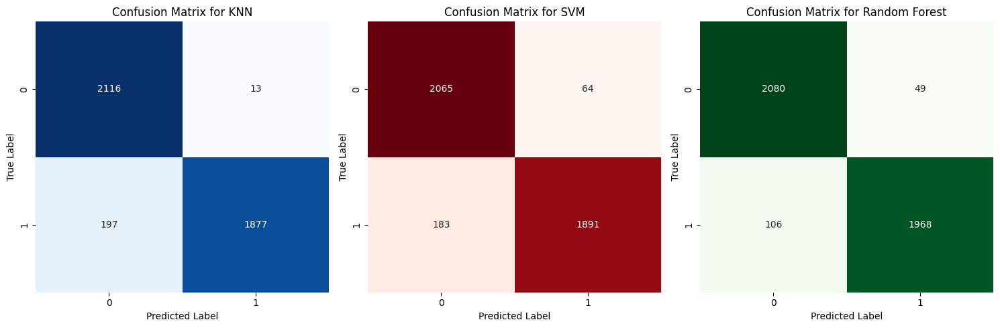

In [59]:
#@title Confusion Matrix
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

# Plot confusion matrices side by side with different colors

# Confusion matrix for KNN
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
sns.heatmap(confusion_matrix(ptb_y_test, ptb_y_pred_knn), annot=True, fmt='d', cmap='Blues',cbar=False)
plt.title("Confusion Matrix for KNN")
plt.xlabel('Predicted Label')
plt.ylabel('True Label')

# Confusion matrix for SVM
plt.subplot(1, 3, 2)
sns.heatmap(confusion_matrix(ptb_y_test, ptb_y_pred_svm), annot=True, fmt='d', cmap='Reds',cbar=False)
plt.title("Confusion Matrix for SVM")
plt.xlabel('Predicted Label')
plt.ylabel('True Label')

# Confusion matrix for Random Forest
plt.subplot(1, 3, 3)
sns.heatmap(confusion_matrix(ptb_y_test, ptb_y_pred_rf), annot=True, fmt='d', cmap='Greens',cbar=False)
plt.title("Confusion Matrix for Random Forest")
plt.xlabel('Predicted Label')
plt.ylabel('True Label')

plt.tight_layout()
plt.show()

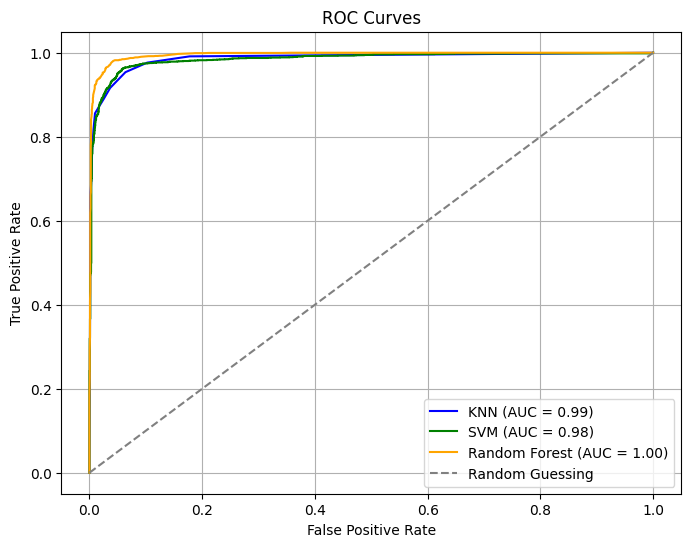

In [73]:
#@title ROC curve

from sklearn.metrics import roc_curve, roc_auc_score
import matplotlib.pyplot as plt
from sklearn.svm import SVC


fpr_knn, tpr_knn, thresholds_knn = roc_curve(ptb_y_test, knn.predict_proba(ptb_X_test)[:, 1])
auc_knn = roc_auc_score(ptb_y_test, knn.predict_proba(ptb_X_test)[:, 1])


# Ensure the SVM model used for ROC curve plotting has probability=True
svm_roc = SVC(kernel='poly', degree=3, gamma='scale', coef0=1, probability=True, random_state=42)
svm_roc.fit(ptb_X_train, ptb_y_train)

fpr_svm, tpr_svm, thresholds_svm = roc_curve(ptb_y_test, svm_roc.predict_proba(ptb_X_test)[:, 1])
auc_svm = roc_auc_score(ptb_y_test, svm_roc.predict_proba(ptb_X_test)[:, 1])


fpr_rf, tpr_rf, thresholds_rf = roc_curve(ptb_y_test, rf.predict_proba(ptb_X_test)[:, 1])
auc_rf = roc_auc_score(ptb_y_test, rf.predict_proba(ptb_X_test)[:, 1])


plt.figure(figsize=(8, 6))
plt.plot(fpr_knn, tpr_knn, label=f'KNN (AUC = {auc_knn:.2f})', color='blue')
plt.plot(fpr_svm, tpr_svm, label=f'SVM (AUC = {auc_svm:.2f})', color='green')
plt.plot(fpr_rf, tpr_rf, label=f'Random Forest (AUC = {auc_rf:.2f})', color='orange')

# Plot random guessing (baseline) line
plt.plot([0, 1], [0, 1], linestyle='--', color='gray', label='Random Guessing')

plt.title('ROC Curves')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.grid(True)
plt.show()

In [76]:
#@title 1D CNN
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, BatchNormalization, Activation, Dropout, Flatten, Dense
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import accuracy_score

# 1D CNN

# Reshape data to have single channel for 1D CNN (assuming pca_features)
ptb_X_train_cnn = ptb_X_train.reshape((ptb_X_train.shape[0], ptb_X_train.shape[1], 1))
ptb_X_test_cnn = ptb_X_test.reshape((ptb_X_test.shape[0], ptb_X_test.shape[1], 1))

# Define 1D CNN model architecture
model = Sequential([
    Conv1D(filters=64, kernel_size=3, padding='same', input_shape=(ptb_X_train_cnn.shape[1], 1)),
    BatchNormalization(),
    Activation('relu'),
    Dropout(0.3),

    Conv1D(filters=128, kernel_size=3, padding='same'),
    BatchNormalization(),
    Activation('relu'),
    Dropout(0.3),

    Flatten(),
    Dense(64, activation='relu'),
    Dropout(0.4),
    Dense(1, activation='sigmoid')
])

# Compile model
model.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=['accuracy'])

# Train model
ptb_history = model.fit(ptb_X_train_cnn, ptb_y_train, epochs=30, batch_size=32, validation_split=0.2)

# Evaluate on training data
ptb_train_loss, ptb_train_acc = model.evaluate(ptb_X_train_cnn, ptb_y_train, verbose=0)
print(f"Training Accuracy: {ptb_train_acc:.4f}")

# Evaluate on test data
ptb_test_loss, ptb_test_acc = model.evaluate(ptb_X_test_cnn, ptb_y_test, verbose=0)
print(f"Test Accuracy: {ptb_test_acc:.4f}")

# Predict function example - predict classes on test set
ptb_y_pred_prob = model.predict(ptb_X_test_cnn)
ptb_y_pred = (ptb_y_pred_prob > 0.5).astype(int).flatten()

# Print accuracy of CNN predictions
ptb_cnn_accuracy = accuracy_score(ptb_y_test, ptb_y_pred)
print(f"CNN Accuracy (from sklearn): {ptb_cnn_accuracy:.4f}")


/usr/local/lib/python3.12/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 11s 18ms/step - accuracy: 0.7552 - loss: 0.5196 - val_accuracy: 0.8308 - val_loss: 0.3794
Epoch 2/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 10s 24ms/step - accuracy: 0.8556 - loss: 0.3351 - val_accuracy: 0.9001 - val_loss: 0.2619
Epoch 3/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 19s 21ms/step - accuracy: 0.8754 - loss: 0.2891 - val_accuracy: 0.9173 - val_loss: 0.2310
Epoch 4/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 9s 21ms/step - accuracy: 0.8857 - loss: 0.2700 - val_accuracy: 0.9111 - val_loss: 0.2244
Epoch 5/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.8947 - loss: 0.2500 - val_accuracy: 0.9250 - val_loss: 0.2079
Epoch 6/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 11s 17ms/step - accuracy: 0.8954 - loss: 0.2417 - val_accuracy: 0.9286 - val_loss: 0.1990
Epoch 7/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 9s 20ms/step - accuracy: 0.9098 - loss: 0.2171 - val_accuracy: 0.9384 - val_loss: 0.1837
Epoch 8/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 9s 17ms/step - accuracy: 0.9136 - loss: 0.2056 - val_

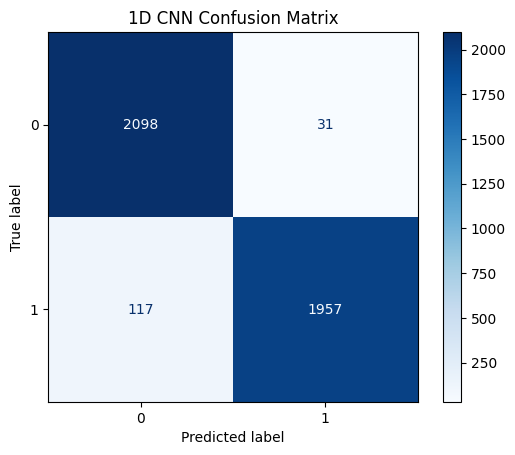

In [77]:
#@title 1D CNN Confusion Matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Compute confusion matrix
cm = confusion_matrix(ptb_y_test, ptb_y_pred)

# Plot
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
disp.plot(cmap='Blues', values_format='d')
plt.title("1D CNN Confusion Matrix")
plt.show()


In [35]:
#@title 1D CNN + Residual Style
import numpy as np
from tensorflow.keras.models import Model
from tensorflow.keras.layers import (
    Input, Conv1D, BatchNormalization, Activation,
    Dropout, Add, GlobalAveragePooling1D, Dense
)
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau

# Reshape input as before
ptb_X_train_cnn = ptb_X_train.reshape((ptb_X_train.shape[0], ptb_X_train.shape[1], 1))
ptb_X_test_cnn  = ptb_X_test.reshape((ptb_X_test.shape[0],  ptb_X_test.shape[1],  1))

# ---- Model ----
inputs = Input(shape=(ptb_X_train_cnn.shape[1], 1))

def conv_block(x, filters, kernel=3, drop=0.25):
    y = Conv1D(filters, kernel, padding="same")(x)
    y = BatchNormalization()(y)
    y = Activation("relu")(y)
    y = Dropout(drop)(y)
    return y

# Initial block
x = conv_block(inputs, 64)
x = conv_block(x, 64)

# Residual-style block
res = x
x = conv_block(x, 128)
x = conv_block(x, 128)
# Project residual to same dims
res = Conv1D(128, 1, padding="same")(res)
x = Add()([x, res])
x = Activation("relu")(x)

# Deeper block
x = conv_block(x, 256, drop=0.3)
x = conv_block(x, 256, drop=0.3)

# Global average pooling instead of Flatten
x = GlobalAveragePooling1D()(x)
x = Dense(128, activation="relu")(x)
x = Dropout(0.4)(x)
outputs = Dense(1, activation="sigmoid")(x)

model = Model(inputs, outputs)

model.compile(
    optimizer=Adam(learning_rate=1e-3),
    loss="binary_crossentropy",
    metrics=["accuracy"]
)

# ---- Training ----
reduce_lr = ReduceLROnPlateau(monitor="val_loss", factor=0.5, patience=4, verbose=1)
history = model.fit(
    ptb_X_train_cnn, ptb_y_train,
    epochs=10,
    batch_size=16,
    validation_split=0.2,
    callbacks=[reduce_lr]
)

# ---- Evaluation ----
train_loss, train_acc = model.evaluate(ptb_X_train_cnn, ptb_y_train, verbose=0)
test_loss,  test_acc  = model.evaluate(ptb_X_test_cnn,  ptb_y_test,  verbose=0)
print(f"Train Acc: {train_acc:.4f} | Test Acc: {test_acc:.4f}")


Epoch 1/10
841/841 ━━━━━━━━━━━━━━━━━━━━ 63s 63ms/step - accuracy: 0.7101 - loss: 0.5596 - val_accuracy: 0.8165 - val_loss: 0.4345 - learning_rate: 0.0010
Epoch 2/10
841/841 ━━━━━━━━━━━━━━━━━━━━ 48s 57ms/step - accuracy: 0.8096 - loss: 0.4383 - val_accuracy: 0.8296 - val_loss: 0.4073 - learning_rate: 0.0010
Epoch 3/10
841/841 ━━━━━━━━━━━━━━━━━━━━ 84s 59ms/step - accuracy: 0.8343 - loss: 0.3972 - val_accuracy: 0.8314 - val_loss: 0.3743 - learning_rate: 0.0010
Epoch 4/10
841/841 ━━━━━━━━━━━━━━━━━━━━ 48s 57ms/step - accuracy: 0.8402 - loss: 0.3734 - val_accuracy: 0.8644 - val_loss: 0.3050 - learning_rate: 0.0010
Epoch 5/10
841/841 ━━━━━━━━━━━━━━━━━━━━ 50s 60ms/step - accuracy: 0.8541 - loss: 0.3437 - val_accuracy: 0.8816 - val_loss: 0.2900 - learning_rate: 0.0010
Epoch 6/10
841/841 ━━━━━━━━━━━━━━━━━━━━ 81s 59ms/step - accuracy: 0.8584 - loss: 0.3255 - val_accuracy: 0.8736 - val_loss: 0.2848 - learning_rate: 0.0010
Epoch 7/10
841/841 ━━━━━━━━━━━━━━━━━━━━ 82s 59ms/step - accuracy: 0.8659 - l

132/132 ━━━━━━━━━━━━━━━━━━━━ 6s 41ms/step
Confusion Matrix:
 [[1852  277]
 [ 137 1937]]


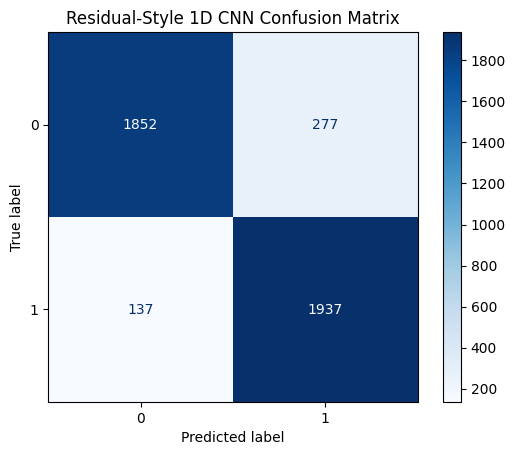

In [37]:
#@title 1D CNN Confusion Matrix

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import numpy as np
import matplotlib.pyplot as plt

# ---- 1. Predict on the test set ----
# For binary classification, we threshold the sigmoid output at 0.5
ptb_y_pred_prob = model.predict(ptb_X_test_cnn)
ptb_y_pred = (ptb_y_pred_prob > 0.5).astype(int).flatten()

# ---- 2. Compute confusion matrix ----
cm = confusion_matrix(ptb_y_test, ptb_y_pred)
print("Confusion Matrix:\n", cm)

# ---- 3. Plot confusion matrix ----
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
disp.plot(cmap='Blues', values_format='d')  # 'd' for integer counts
plt.title("Residual-Style 1D CNN Confusion Matrix")
plt.show()


In [39]:
#@title LSTM

import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import accuracy_score

#LSTM

# Reshape data to 3D tensor for LSTM: (samples, timesteps, features)
# Assuming your PCA features are treated as timesteps with 1 feature each (adjust if needed)
ptb_X_train_lstm = ptb_X_train.reshape((ptb_X_train.shape[0], ptb_X_train.shape[1], 1))
ptb_X_test_lstm = ptb_X_test.reshape((ptb_X_test.shape[0], ptb_X_test.shape[1], 1))

# Define LSTM model architecture
model = Sequential([
    LSTM(units=64, return_sequences=True, input_shape=(ptb_X_train_lstm.shape[1], 1)),
    Dropout(0.3),
    LSTM(units=32),
    Dropout(0.3),
    Dense(16, activation='relu'),
    Dropout(0.3),
    Dense(1, activation='sigmoid')
])

# Compile model
model.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=['accuracy'])

# Train model
ptb_history = model.fit(ptb_X_train_lstm, ptb_y_train, epochs=30, batch_size=32, validation_split=0.2)

# Evaluate on training data
ptb_train_loss, ptb_train_acc = model.evaluate(ptb_X_train_lstm, ptb_y_train, verbose=0)
print(f"Training Accuracy: {ptb_train_acc:.4f}")

# Evaluate on test data
ptb_test_loss, ptb_test_acc = model.evaluate(ptb_X_test_lstm, ptb_y_test, verbose=0)
print(f"Test Accuracy: {ptb_test_acc:.4f}")

# Predict on test set
ptb_y_pred_prob = model.predict(ptb_X_test_lstm)
ptb_y_pred = (ptb_y_pred_prob > 0.5).astype(int).flatten()

# Print classification accuracy
ptb_cnn_accuracy = accuracy_score(ptb_y_test, ptb_y_pred)
print(f"LSTM Model Accuracy: {ptb_cnn_accuracy:.4f}")


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 60s 39ms/step - accuracy: 0.5099 - loss: 0.6933 - val_accuracy: 0.5354 - val_loss: 0.6847
Epoch 2/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 16s 37ms/step - accuracy: 0.5231 - loss: 0.6878 - val_accuracy: 0.5904 - val_loss: 0.6715
Epoch 3/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 20s 36ms/step - accuracy: 0.6196 - loss: 0.6419 - val_accuracy: 0.6740 - val_loss: 0.5846
Epoch 4/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 15s 36ms/step - accuracy: 0.6858 - loss: 0.5776 - val_accuracy: 0.7281 - val_loss: 0.5411
Epoch 5/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 16s 37ms/step - accuracy: 0.7215 - loss: 0.5486 - val_accuracy: 0.7442 - val_loss: 0.5235
Epoch 6/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 20s 37ms/step - accuracy: 0.7511 - loss: 0.5149 - val_accuracy: 0.7603 - val_loss: 0.5183
Epoch 7/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 21s 37ms/step - accuracy: 0.7582 - loss: 0.5049 - val_accuracy: 0.7704 - val_loss: 0.4985
Epoch 8/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 15s 36ms/step - accuracy: 0.7683 - loss: 0.5000 - 

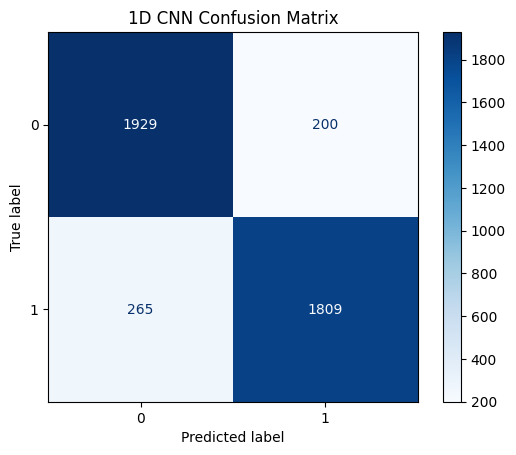

In [40]:
#@title LSTM Confusion Matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Compute confusion matrix
cm = confusion_matrix(ptb_y_test, ptb_y_pred)

# Plot
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
disp.plot(cmap='Blues', values_format='d')
plt.title("1D CNN Confusion Matrix")
plt.show()

In [41]:
#@title Residual Network

import tensorflow as tf
from tensorflow.keras.layers import Input, Conv1D, BatchNormalization, Activation, Add, GlobalAveragePooling1D, Dense, Dropout
from tensorflow.keras.models import Model

# Residual Networks (ResNet)

def residual_block(x, filters, kernel_size=3, stride=1):
    # Shortcut path
    shortcut = x

    # First conv layer
    x = Conv1D(filters=filters, kernel_size=kernel_size, strides=stride, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    # Second conv layer
    x = Conv1D(filters=filters, kernel_size=kernel_size, strides=1, padding='same')(x)
    x = BatchNormalization()(x)

    # Adjust shortcut if shape change due to stride or filter numbers
    if stride != 1 or shortcut.shape[-1] != filters:
        shortcut = Conv1D(filters=filters, kernel_size=1, strides=stride, padding='same')(shortcut)
        shortcut = BatchNormalization()(shortcut)

    # Add shortcut and main path
    x = Add()([x, shortcut])
    x = Activation('relu')(x)
    return x

# Input shape: (timesteps, channels)
input_shape = (ptb_X_train.shape[1], 1)  # reshape your features accordingly

inputs = Input(shape=input_shape)
x = Conv1D(64, kernel_size=7, strides=2, padding='same')(inputs)
x = BatchNormalization()(x)
x = Activation('relu')(x)

x = residual_block(x, 64)
x = residual_block(x, 64)

x = residual_block(x, 128, stride=2)
x = residual_block(x, 128)

x = residual_block(x, 256, stride=2)
x = residual_block(x, 256)

x = GlobalAveragePooling1D()(x)
x = Dropout(0.4)(x)
outputs = Dense(1, activation='sigmoid')(x)

model = Model(inputs, outputs)

model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Reshape your data for the model as (samples, timesteps, channels)
ptb_X_train_resnet = ptb_X_train.reshape((ptb_X_train.shape[0], ptb_X_train.shape[1], 1))
ptb_X_test_resnet = ptb_X_test.reshape((ptb_X_test.shape[0], ptb_X_test.shape[1], 1))

# Train the model
ptb_history = model.fit(ptb_X_train_resnet, ptb_y_train, validation_split=0.2, epochs=30, batch_size=32)

# Evaluate
ptb_train_loss, ptb_train_acc = model.evaluate(ptb_X_train_resnet, ptb_y_train, verbose=0)
ptb_test_loss, ptb_test_acc = model.evaluate(ptb_X_test_resnet, ptb_y_test, verbose=0)

print(f"Training Accuracy: {ptb_train_acc:.4f}")
print(f"Test Accuracy: {ptb_test_acc:.4f}")

# Predict on test set
ptb_y_pred_prob = model.predict(ptb_X_test_resnet)
ptb_y_pred = (ptb_y_pred_prob > 0.5).astype(int).flatten()

from sklearn.metrics import accuracy_score
print(f"ResNet Model Accuracy (sklearn): {accuracy_score(ptb_y_test, ptb_y_pred):.4f}")


Epoch 1/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 48s 82ms/step - accuracy: 0.8133 - loss: 0.4148 - val_accuracy: 0.7115 - val_loss: 0.6226
Epoch 2/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 33s 77ms/step - accuracy: 0.9273 - loss: 0.1908 - val_accuracy: 0.9393 - val_loss: 0.1754
Epoch 3/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 41s 77ms/step - accuracy: 0.9403 - loss: 0.1560 - val_accuracy: 0.9506 - val_loss: 0.1370
Epoch 4/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 41s 77ms/step - accuracy: 0.9548 - loss: 0.1184 - val_accuracy: 0.9453 - val_loss: 0.1469
Epoch 5/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 34s 80ms/step - accuracy: 0.9568 - loss: 0.1156 - val_accuracy: 0.9590 - val_loss: 0.1224
Epoch 6/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 41s 81ms/step - accuracy: 0.9668 - loss: 0.0903 - val_accuracy: 0.9548 - val_loss: 0.1458
Epoch 7/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 42s 84ms/step - accuracy: 0.9726 - loss: 0.0738 - val_accuracy: 0.9527 - val_loss: 0.1519
Epoch 8/30
421/421 ━━━━━━━━━━━━━━━━━━━━ 38s 77ms/step - accuracy: 0.9734 - loss: 0.0706 - 

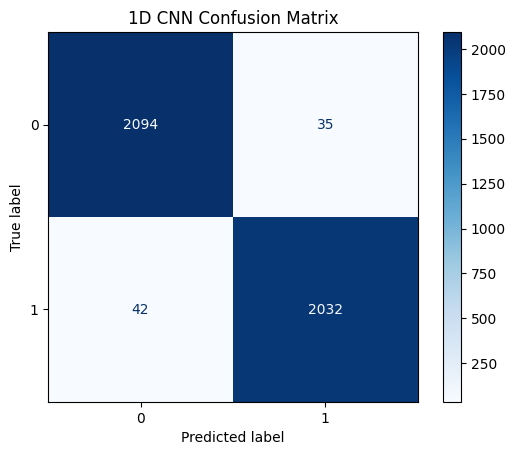

In [42]:
#@title Residual Network Confusion Matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Compute confusion matrix
cm = confusion_matrix(ptb_y_test, ptb_y_pred)

# Plot
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
disp.plot(cmap='Blues', values_format='d')
plt.title("1D CNN Confusion Matrix")
plt.show()

Number of beats concatenated: 200
Concatenated series length: 9000 samples


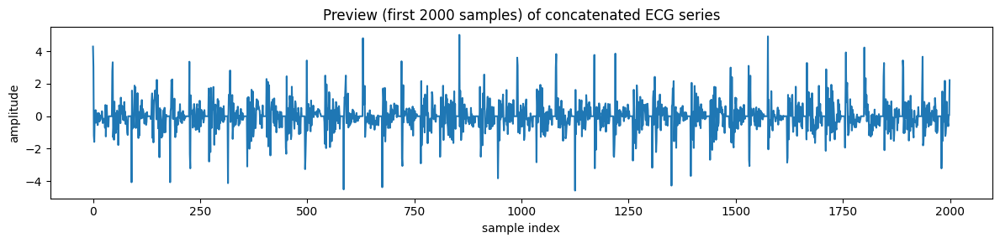

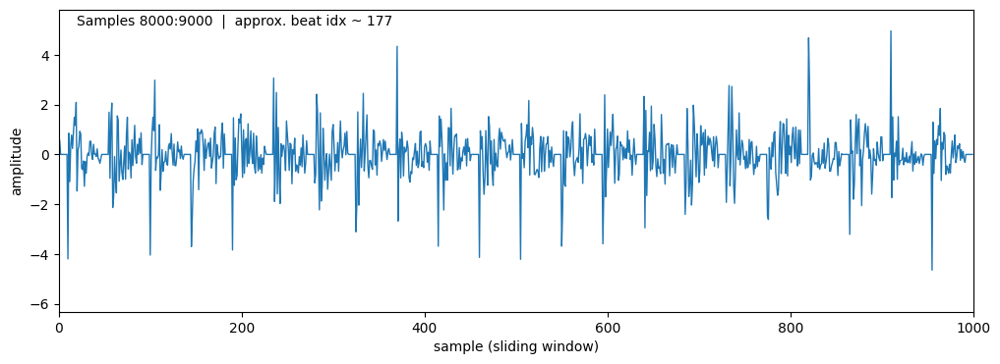

In [89]:
#@title Hearbeat Series

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import random
from IPython.display import HTML, display

# -----------------------------
# USER CONFIGURABLE PARAMETERS
# -----------------------------
# 'data' is assumed to be a numpy array of shape (n_samples, 187)
# where each row is one beat (many rows padded with zeros).
#
# Example: data = np.loadtxt("ptb_beats.csv", delimiter=",")  # or however you load it

# How many beats to concatenate into the time series (use <= len(data))
NUM_BEATS_TO_USE = 25            # lower value for quicker animation; increase as needed
USE_RANDOM_ORDER = False         # True = choose beats randomly; False = use sequential order
GAP_BETWEEN_BEATS = 8            # number of zeros inserted between beats for visible separation
MAX_BEAT_LENGTH = 187            # original beat length (for info)

# Animation settings
WINDOW_SAMPLES = 1000            # sliding window length (how many samples visible in figure)
STEP_PER_FRAME = 5               # how many samples the window advances each frame
INTERVAL_MS = 25                 # ms between frames (smaller = faster animation)
FIGSIZE = (12, 4)                # figure size

# Optional: normalize each beat before concatenation (True/False)
NORMALIZE_EACH_BEAT = True

# -----------------------------
# Validate 'data' exists
# -----------------------------
data = ptb_X_train.copy()
try:
    data
except NameError:
    raise RuntimeError("Variable 'data' not found. Place your loaded numpy array named `data` (shape: n x 187) in the environment.")

if not isinstance(data, np.ndarray):
    raise RuntimeError("`data` must be a numpy.ndarray (shape: n_samples x 187).")

n_samples = data.shape[0]
if data.shape[1] != MAX_BEAT_LENGTH:
    # adjust MAX_BEAT_LENGTH for your dataset
    MAX_BEAT_LENGTH = data.shape[1]

# -----------------------------
# 1) Build concatenated series
# -----------------------------
def trim_beat(beat_row):
    """
    Remove leading/trailing zero padding from a single beat row.
    Uses numpy.trim_zeros which removes zeros at both ends.
    """
    # Convert to 1D vector and trim
    arr = np.asarray(beat_row).astype(float).flatten()
    trimmed = np.trim_zeros(arr, 'fb')  # 'fb' removes front & back zeros
    # If trimming removes everything (edge-case), fall back to original small slice:
    if trimmed.size == 0:
        # try removing only trailing zeros
        trimmed = arr[np.nonzero(arr)] if np.any(arr != 0) else arr
        if isinstance(trimmed, tuple):  # fallback safety
            trimmed = arr
    return trimmed

# Choose indices for the series
if USE_RANDOM_ORDER:
    chosen_idxs = random.sample(range(n_samples), min(NUM_BEATS_TO_USE, n_samples))
else:
    chosen_idxs = list(range(min(NUM_BEATS_TO_USE, n_samples)))

beat_list = []
for i in chosen_idxs:
    beat = trim_beat(data[i])
    if beat.size == 0:
        # skip completely empty rows
        continue
    if NORMALIZE_EACH_BEAT:
        # avoid divide-by-zero
        std = np.std(beat)
        if std > 0:
            beat = (beat - np.mean(beat)) / std
        else:
            beat = beat - np.mean(beat)
    beat_list.append(beat)

# Insert small zero gaps between beats so transitions are visible
gap = np.zeros(GAP_BETWEEN_BEATS)
concatenated = []
for beat in beat_list:
    concatenated.append(beat)
    concatenated.append(gap)
if len(concatenated) == 0:
    raise RuntimeError("No valid beats found after trimming. Check your data and padding.")
concatenated_series = np.concatenate(concatenated)

print(f"Number of beats concatenated: {len(beat_list)}")
print(f"Concatenated series length: {concatenated_series.size} samples")

# -----------------------------
# 2) Simple static plot (preview)
# -----------------------------
plt.figure(figsize=(12,3))
plt.plot(concatenated_series[:min(2000, concatenated_series.size)])
plt.title("Preview (first 2000 samples) of concatenated ECG series")
plt.xlabel("sample index")
plt.ylabel("amplitude")
plt.tight_layout()
plt.show()

# -----------------------------
# 3) Live moving animation (sliding window)
# -----------------------------
fig, ax = plt.subplots(figsize=FIGSIZE)
line, = ax.plot([], [], lw=1)
ax.set_xlim(0, WINDOW_SAMPLES)
# Set y-limits from global series to avoid autoscale jumps:
ymin = np.min(concatenated_series)
ymax = np.max(concatenated_series)
yrange = ymax - ymin
if yrange == 0:
    # fallback if flat signal
    ymin -= 1
    ymax += 1
else:
    # add a little padding
    ymin -= 0.05 * yrange
    ymax += 0.05 * yrange
ax.set_ylim(ymin, ymax)
ax.set_xlabel("sample (sliding window)")
ax.set_ylabel("amplitude")
title_text = ax.text(0.02, 0.95, "", transform=ax.transAxes)

# Precompute number of frames
total_samples = concatenated_series.size
max_start = max(0, total_samples - WINDOW_SAMPLES)
n_frames = max(1, max_start // STEP_PER_FRAME + 1)

def init():
    line.set_data([], [])
    title_text.set_text("")
    return line, title_text

def update(frame_idx):
    start = frame_idx * STEP_PER_FRAME
    end = start + WINDOW_SAMPLES
    if end > total_samples:
        end = total_samples
        start = max(0, end - WINDOW_SAMPLES)
    window = concatenated_series[start:end]
    x = np.arange(window.size)
    # If window shorter than WINDOW_SAMPLES, pad x to keep x-range consistent
    line.set_data(x, window)
    # Update x-limits if window length shorter (keeps view consistent)
    ax.set_xlim(0, WINDOW_SAMPLES if window.size >= WINDOW_SAMPLES else window.size)
    beat_index_est = int(start / (MAX_BEAT_LENGTH + GAP_BETWEEN_BEATS))  # rough estimate
    title_text.set_text(f"Samples {start}:{end}  |  approx. beat idx ~ {beat_index_est}")
    return line, title_text

anim = FuncAnimation(
    fig,
    update,
    frames=n_frames,
    init_func=init,
    blit=True,
    interval=INTERVAL_MS,
    repeat=True
)

# Display the animation in Colab
display(HTML(anim.to_jshtml()))

# Optionally: save animation to mp4 (requires ffmpeg installed)
# anim.save("ecg_concatenated_animation.mp4", fps=1000/INTERVAL_MS, dpi=150)

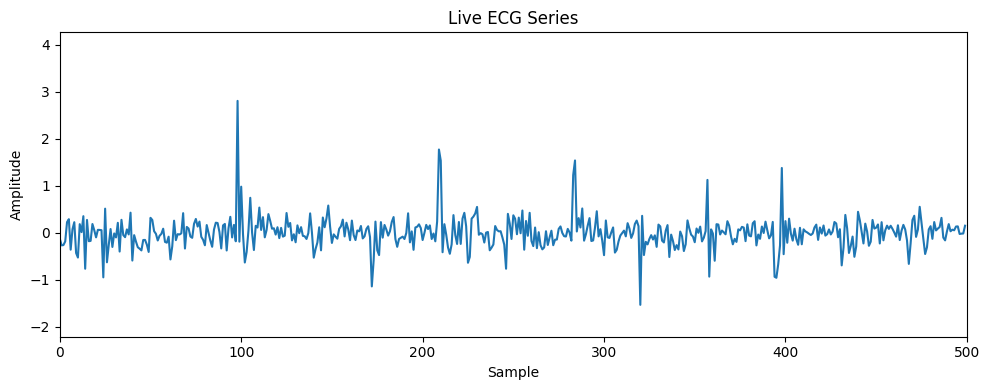

In [44]:
#@title Heart Beat Series 2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display # Import display and HTML

data = ptb_X_train[:30,:].copy()
# -----------------------
# 1. Load and prepare data
# -----------------------
# Assume your CSV is loaded into a DataFrame called `data`
# Each row is a heartbeat of length 187
# data = pd.read_csv("ptb_heartbeats.csv")

def concat_beats_remove_zeros(data_array):
    """
    Remove trailing zeros from each heartbeat row
    and concatenate them into a single long 1-D array.
    Assumes input is a numpy array.
    """
    beats = []
    for row in data_array: # Iterate directly over numpy array rows
        row = np.asarray(row)
        # Remove trailing zeros (padding)
        nonzero = row[row != 0]
        if len(nonzero) > 0:
            beats.append(nonzero)
    return np.concatenate(beats)

# Create the long 1-D ECG signal
signal = concat_beats_remove_zeros(data)

# -----------------------
# 2. Animation setup
# -----------------------
window_size = 500      # samples visible at a time
update_step = 5        # how many samples to shift per frame
fps = 30               # frames per second

fig, ax = plt.subplots(figsize=(10, 4))
ax.set_title("Live ECG Series")
ax.set_xlabel("Sample")
ax.set_ylabel("Amplitude")
line, = ax.plot([], [], lw=1.5)
ax.set_xlim(0, window_size)
ax.set_ylim(signal.min() * 1.1, signal.max() * 1.1)

# -----------------------
# 3. Update function
# -----------------------
def update(frame):
    start = frame * update_step
    end = start + window_size
    if end >= len(signal):
        end = len(signal)
        start = end - window_size
    x = np.arange(window_size)
    y = signal[start:end]
    line.set_data(x[:len(y)], y)
    return line,

# -----------------------
# 4. Create animation
# -----------------------
frames = (len(signal) - window_size) // update_step
ani = FuncAnimation(
    fig,
    update,
    frames=frames,
    blit=True,
    interval=1000 / fps,  # milliseconds between frames
    repeat=False
)

plt.tight_layout()
# Add this line to display the animation in Colab
display(HTML(ani.to_jshtml()))
# plt.show() # This is generally not needed when using display(HTML()) for animation

## MIT-BIH Arrhythmia Dataset

In [ ]:
Arr_train_data = pd.read_csv(r"/content/drive/MyDrive/MI Detection/Data/mitbih_train.csv",header=None)
#This is the normal ptbdb where the last column for all rows is 0 meaning these patients were healthy.

In [ ]:
Arr_train_data.head(2)

,0,1,2,3,4,5,6,7,8,9,...,178,179,180,181,182,183,184,185,186,187
0,0.977941,0.926471,0.681373,0.245098,0.154412,0.191176,0.151961,0.085784,0.058824,0.049020,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.960114,0.863248,0.461538,0.196581,0.094017,0.125356,0.099715,0.088319,0.074074,0.082621,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
print("Train Data shape: ", Arr_train_data.shape)

Train Data shape:  (87554, 188)


In [ ]:
Arr_test_data = pd.read_csv(r"/content/drive/MyDrive/MI Detection/Data/mitbih_test.csv",header=None)
#The last column is observed to be 1 for all rows meaning these patients were infected with MI

In [ ]:
Arr_test_data.head(2)

,0,1,2,3,4,5,6,7,8,9,...,178,179,180,181,182,183,184,185,186,187
0,1.000000,0.758264,0.111570,0.000000,0.080579,0.078512,0.066116,0.049587,0.047521,0.035124,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.908425,0.783883,0.531136,0.362637,0.366300,0.344322,0.333333,0.307692,0.296703,0.300366,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Sampling frequency = 125Hz

This indicates that the time scale = 1/125 = 0.008seconds

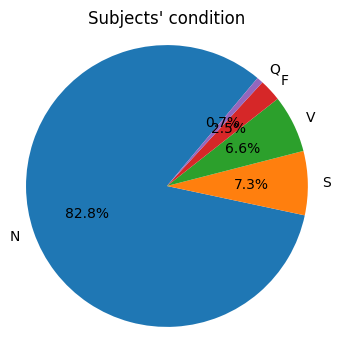

In [ ]:
#@title Data Distribution  Before SMOTE
# Assuming the last column is named 'Status' where ['N': 0, 'S': 1, 'V': 2, 'F': 3, 'Q': 4]

# Count occurrences of each category
Arr_status_counts = Arr_all_data['Status'].value_counts()
Arr_label = ['N', 'S', 'V', 'F', 'Q']

# Plot the pie chart
plt.figure(figsize=(4, 4))
plt.pie(Arr_status_counts, labels=Arr_label, autopct='%1.1f%%', startangle=50)
plt.title("Subjects' condition")
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.show()

In [ ]:
#@title Concatenate Data
Arr_concatenated_data = pd.concat([Arr_train_data, Arr_test_data],ignore_index=True)
Arr_shuffled_data = Arr_concatenated_data.sample(frac=1, random_state=0) # shuffle the data
Arr_shuffled_data.head(2)

,0,1,2,3,4,5,6,7,8,9,...,178,179,180,181,182,183,184,185,186,187
102653,1.000000,0.684000,0.048000,0.068000,0.160000,0.112000,0.076000,0.072000,0.056000,0.076000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25053,0.477444,0.090226,0.184211,0.342105,0.432331,0.484962,0.469925,0.458647,0.488722,0.507519,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
#@title Shuffle Data
Arr_all_data = Arr_shuffled_data
Arr_all_data.reset_index(drop=True, inplace=True)
Arr_all_data.shape

(109446, 188)

In [ ]:
#@title Status (labels)
Arr_all_data.rename(columns={ndata.columns[-1]: 'Status'}, inplace=True)

In [ ]:
Arr_all_data.head(2)

,0,1,2,3,4,5,6,7,8,9,...,178,179,180,181,182,183,184,185,186,Status
0,1.000000,0.684000,0.048000,0.068000,0.160000,0.112000,0.076000,0.072000,0.056000,0.076000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.477444,0.090226,0.184211,0.342105,0.432331,0.484962,0.469925,0.458647,0.488722,0.507519,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
Arr_data = Arr_all_data.iloc[:,:-1]
Arr_data.shape

(109446, 187)

In [ ]:
#@title Features and Labels
# Extract the features and labels
Arr_X = Arr_all_data.iloc[:, :-1]
Arr_y = Arr_all_data.iloc[:, -1]

# Apply SMOTE to balance the class distribution
smote = SMOTE(random_state=42)
Arr_X_resampled, Arr_y_resampled = smote.fit_resample(Arr_X, Arr_y)

# Check the class distribution after resampling
Arr_unique, Arr_counts = np.unique(Arr_y_resampled, return_counts=True)
print("Class distribution after resampling:", dict(zip(Arr_unique, Arr_counts)))

Class distribution after resampling: {np.float64(0.0): np.int64(90589), np.float64(1.0): np.int64(90589), np.float64(2.0): np.int64(90589), np.float64(3.0): np.int64(90589), np.float64(4.0): np.int64(90589)}


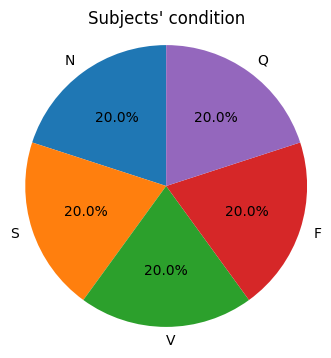

In [ ]:
#@title Data Distribution After SMOTE
# Assuming the last column is named 'Status' where ['N': 0, 'S': 1, 'V': 2, 'F': 3, 'Q': 4]

# Count occurrences of each category
#status_counts = all_data['Status'].value_counts()
Arr_label = ['N', 'S', 'V', 'F', 'Q']


# Plot the pie chart
plt.figure(figsize=(4, 4))
plt.pie(Arr_counts, labels=Arr_label, autopct='%1.1f%%', startangle=90)
plt.title("Subjects' condition")
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.show()

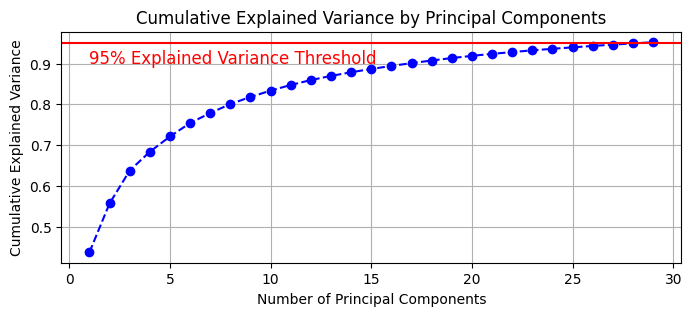

Shape of PCA features after SMOTE: (452945, 29)


In [ ]:
#@title PCA

pca = PCA(n_components=0.95)  # Retain 95% of variance
pca.fit(Arr_X_resampled)

# Calculate cumulative explained variance ratio
Arr_cumulative_variance = np.cumsum(pca.explained_variance_ratio_)

# Plot cumulative variance
plt.figure(figsize=(8, 3))
plt.plot(range(1, len(Arr_cumulative_variance) + 1), Arr_cumulative_variance, marker='o', linestyle='--', color='b')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Cumulative Explained Variance by Principal Components')
plt.grid(True)
plt.axhline(y=0.95, color='r', linestyle='-')
plt.text(1, 0.90, '95% Explained Variance Threshold', color='red', fontsize=12)
plt.show()

# Transform the data
Arr_pca_features = pca.transform(Arr_X_resampled)

# Print the shape of PCA features
print("Shape of PCA features after SMOTE:", Arr_pca_features.shape)

In [ ]:
from sklearn.model_selection import train_test_split
Arr_X_train, Arr_X_test, Arr_y_train, Arr_y_test = train_test_split(Arr_pca_features, Arr_y_resampled, test_size=0.03, random_state=42)

In [ ]:
print("The shape of X_train : ", Arr_X_train.shape)
print("The shape of X_test : ", Arr_X_test.shape)
print("The shape of y_train : ", Arr_y_train.shape)
print("The shape of y_test : ", Arr_y_test.shape)

The shape of X_train :  (439356, 29)
The shape of X_test :  (13589, 29)
The shape of y_train :  (439356,)
The shape of y_test :  (13589,)
